In [1]:
pip install folium


Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install geopandas

Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install esda

Note: you may need to restart the kernel to use updated packages.


In [1]:
import pandas as pd
import numpy as np
import folium
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans, DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.metrics import pairwise_distances
import geopandas as gpd
from shapely.geometry import Point
from scipy.spatial.distance import pdist, squareform
from esda.getisord import G
from libpysal.weights import KNN
from sklearn.datasets import make_classification


In [2]:
df= pd.read_csv(r"C:\Users\Namrata Vasant Borse\Downloads\NYPD_Shooting_Incident_Data__Historic_.csv")

In [3]:
df.head()

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,228798151,05/27/2021,21:30:00,QUEENS,NaN,105,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1.058925e+06,180924.000000,40.662965,-73.730839,POINT (-73.73083868899994 40.662964620000025)
1,137471050,06/27/2014,17:40:00,BRONX,NaN,40,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1.005028e+06,234516.000000,40.810352,-73.924942,POINT (-73.92494232599995 40.81035186300006)
2,147998800,11/21/2015,03:56:00,QUEENS,NaN,108,0.0,NaN,NaN,True,...,NaN,NaN,25-44,M,WHITE,1.007668e+06,209836.531250,40.742607,-73.915492,POINT (-73.91549174199997 40.74260663300004)
3,146837977,10/09/2015,18:30:00,BRONX,NaN,44,0.0,NaN,NaN,False,...,NaN,NaN,<18,M,WHITE HISPANIC,1.006537e+06,244511.140625,40.837782,-73.919457,POINT (-73.91945661499994 40.83778200300003)
4,58921844,02/19/2009,22:58:00,BRONX,NaN,47,0.0,NaN,NaN,True,...,M,BLACK,45-64,M,BLACK,1.024922e+06,262189.406250,40.886238,-73.852910,POINT (-73.85290950899997 40.88623791800006)


In [4]:
df.tail()

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
27307,245029823,05/14/2022,03:02:00,BRONX,OUTSIDE,48,0.0,STREET,(null),False,...,(null),(null),18-24,M,BLACK,1011526.0,247828.0,40.846864,-73.901413,POINT (-73.90141321 40.84686352)
27308,239583450,01/22/2022,13:15:00,MANHATTAN,OUTSIDE,30,0.0,STREET,(null),False,...,F,WHITE HISPANIC,25-44,M,WHITE HISPANIC,997458.0,240485.0,40.826743,-73.952273,POINT (-73.952273 40.826743)
27309,246825728,06/18/2022,03:29:00,MANHATTAN,OUTSIDE,32,0.0,STREET,(null),False,...,M,BLACK,25-44,M,BLACK,1000999.0,234464.0,40.810209,-73.939496,POINT (-73.9394955 40.81020941)
27310,246876579,06/19/2022,20:08:00,BRONX,INSIDE,46,2.0,HOUSING,MULTI DWELL - PUBLIC HOUS,False,...,M,BLACK,25-44,M,WHITE HISPANIC,1012980.0,251028.0,40.855644,-73.896141,POINT (-73.896141 40.855644)
27311,239861542,01/28/2022,18:14:00,BRONX,OUTSIDE,45,0.0,STREET,(null),False,...,M,BLACK,18-24,M,BLACK,1026549.0,244293.0,40.837102,-73.847134,POINT (-73.847134 40.837102)


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27312 entries, 0 to 27311
Data columns (total 21 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   INCIDENT_KEY             27312 non-null  int64  
 1   OCCUR_DATE               27312 non-null  object 
 2   OCCUR_TIME               27312 non-null  object 
 3   BORO                     27312 non-null  object 
 4   LOC_OF_OCCUR_DESC        1716 non-null   object 
 5   PRECINCT                 27312 non-null  int64  
 6   JURISDICTION_CODE        27310 non-null  float64
 7   LOC_CLASSFCTN_DESC       1716 non-null   object 
 8   LOCATION_DESC            12335 non-null  object 
 9   STATISTICAL_MURDER_FLAG  27312 non-null  bool   
 10  PERP_AGE_GROUP           17968 non-null  object 
 11  PERP_SEX                 18002 non-null  object 
 12  PERP_RACE                18002 non-null  object 
 13  VIC_AGE_GROUP            27312 non-null  object 
 14  VIC_SEX               

In [6]:
df.describe()

,INCIDENT_KEY,PRECINCT,JURISDICTION_CODE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
count,2.731200e+04,27312.000000,27310.000000,2.731200e+04,27312.000000,27302.000000,27302.000000
mean,1.208605e+08,65.635362,0.326913,1.009449e+06,208127.401608,40.737892,-73.909051
std,7.341286e+07,27.305705,0.737743,1.837783e+04,31886.377757,0.087525,0.066272
min,9.953245e+06,1.000000,0.000000,9.149281e+05,125756.718750,40.511586,-74.249303
25%,6.386088e+07,44.000000,0.000000,1.000029e+06,182834.335938,40.668481,-73.943027
50%,9.037222e+07,68.000000,0.000000,1.007731e+06,194486.570312,40.700318,-73.915221
75%,1.888102e+08,81.000000,0.000000,1.016838e+06,239518.468750,40.824067,-73.882330
max,2.611902e+08,123.000000,2.000000,1.066815e+06,271127.687500,40.910818,-73.702046


In [7]:
df.isnull().sum()

INCIDENT_KEY                   0
OCCUR_DATE                     0
OCCUR_TIME                     0
BORO                           0
LOC_OF_OCCUR_DESC          25596
PRECINCT                       0
JURISDICTION_CODE              2
LOC_CLASSFCTN_DESC         25596
LOCATION_DESC              14977
STATISTICAL_MURDER_FLAG        0
PERP_AGE_GROUP              9344
PERP_SEX                    9310
PERP_RACE                   9310
VIC_AGE_GROUP                  0
VIC_SEX                        0
VIC_RACE                       0
X_COORD_CD                     0
Y_COORD_CD                     0
Latitude                      10
Longitude                     10
Lon_Lat                       10
dtype: int64

In [8]:
df.columns

Index(['INCIDENT_KEY', 'OCCUR_DATE', 'OCCUR_TIME', 'BORO', 'LOC_OF_OCCUR_DESC',
       'PRECINCT', 'JURISDICTION_CODE', 'LOC_CLASSFCTN_DESC', 'LOCATION_DESC',
       'STATISTICAL_MURDER_FLAG', 'PERP_AGE_GROUP', 'PERP_SEX', 'PERP_RACE',
       'VIC_AGE_GROUP', 'VIC_SEX', 'VIC_RACE', 'X_COORD_CD', 'Y_COORD_CD',
       'Latitude', 'Longitude', 'Lon_Lat'],
      dtype='object')

In [9]:
df = df.drop(columns=['LOC_OF_OCCUR_DESC','LOC_CLASSFCTN_DESC','LOCATION_DESC','PERP_AGE_GROUP','PERP_SEX','PERP_RACE', 'Lon_Lat'])
df.head()

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,PRECINCT,JURISDICTION_CODE,STATISTICAL_MURDER_FLAG,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
0,228798151,05/27/2021,21:30:00,QUEENS,105,0.0,False,18-24,M,BLACK,1.058925e+06,180924.000000,40.662965,-73.730839
1,137471050,06/27/2014,17:40:00,BRONX,40,0.0,False,18-24,M,BLACK,1.005028e+06,234516.000000,40.810352,-73.924942
2,147998800,11/21/2015,03:56:00,QUEENS,108,0.0,True,25-44,M,WHITE,1.007668e+06,209836.531250,40.742607,-73.915492
3,146837977,10/09/2015,18:30:00,BRONX,44,0.0,False,<18,M,WHITE HISPANIC,1.006537e+06,244511.140625,40.837782,-73.919457
4,58921844,02/19/2009,22:58:00,BRONX,47,0.0,True,45-64,M,BLACK,1.024922e+06,262189.406250,40.886238,-73.852910


In [10]:
df.isnull().sum()

INCIDENT_KEY                0
OCCUR_DATE                  0
OCCUR_TIME                  0
BORO                        0
PRECINCT                    0
JURISDICTION_CODE           2
STATISTICAL_MURDER_FLAG     0
VIC_AGE_GROUP               0
VIC_SEX                     0
VIC_RACE                    0
X_COORD_CD                  0
Y_COORD_CD                  0
Latitude                   10
Longitude                  10
dtype: int64

In [11]:
df.fillna(method='ffill')

C:\Users\Namrata Vasant Borse\AppData\Local\Temp\ipykernel_12892\1193302488.py:1: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill')


,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,PRECINCT,JURISDICTION_CODE,STATISTICAL_MURDER_FLAG,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
0,228798151,05/27/2021,21:30:00,QUEENS,105,0.0,False,18-24,M,BLACK,1.058925e+06,180924.000000,40.662965,-73.730839
1,137471050,06/27/2014,17:40:00,BRONX,40,0.0,False,18-24,M,BLACK,1.005028e+06,234516.000000,40.810352,-73.924942
2,147998800,11/21/2015,03:56:00,QUEENS,108,0.0,True,25-44,M,WHITE,1.007668e+06,209836.531250,40.742607,-73.915492
3,146837977,10/09/2015,18:30:00,BRONX,44,0.0,False,<18,M,WHITE HISPANIC,1.006537e+06,244511.140625,40.837782,-73.919457
4,58921844,02/19/2009,22:58:00,BRONX,47,0.0,True,45-64,M,BLACK,1.024922e+06,262189.406250,40.886238,-73.852910
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27307,245029823,05/14/2022,03:02:00,BRONX,48,0.0,False,18-24,M,BLACK,1.011526e+06,247828.000000,40.846864,-73.901413
27308,239583450,01/22/2022,13:15:00,MANHATTAN,30,0.0,False,25-44,M,WHITE HISPANIC,9.974580e+05,240485.000000,40.826743,-73.952273
27309,246825728,06/18/2022,03:29:00,MANHATTAN,32,0.0,False,25-44,M,BLACK,1.000999e+06,234464.000000,40.810209,-73.939496
27310,246876579,06/19/2022,20:08:00,BRONX,46,2.0,False,25-44,M,WHITE HISPANIC,1.012980e+06,251028.000000,40.855644,-73.896141


In [12]:
df.columns.str.lower().str.replace(' ', '_')

Index(['incident_key', 'occur_date', 'occur_time', 'boro', 'precinct',
       'jurisdiction_code', 'statistical_murder_flag', 'vic_age_group',
       'vic_sex', 'vic_race', 'x_coord_cd', 'y_coord_cd', 'latitude',
       'longitude'],
      dtype='object')

In [13]:
df.dropna(subset=['JURISDICTION_CODE','Longitude'], inplace=True)


In [14]:
df.isnull().sum()

INCIDENT_KEY               0
OCCUR_DATE                 0
OCCUR_TIME                 0
BORO                       0
PRECINCT                   0
JURISDICTION_CODE          0
STATISTICAL_MURDER_FLAG    0
VIC_AGE_GROUP              0
VIC_SEX                    0
VIC_RACE                   0
X_COORD_CD                 0
Y_COORD_CD                 0
Latitude                   0
Longitude                  0
dtype: int64

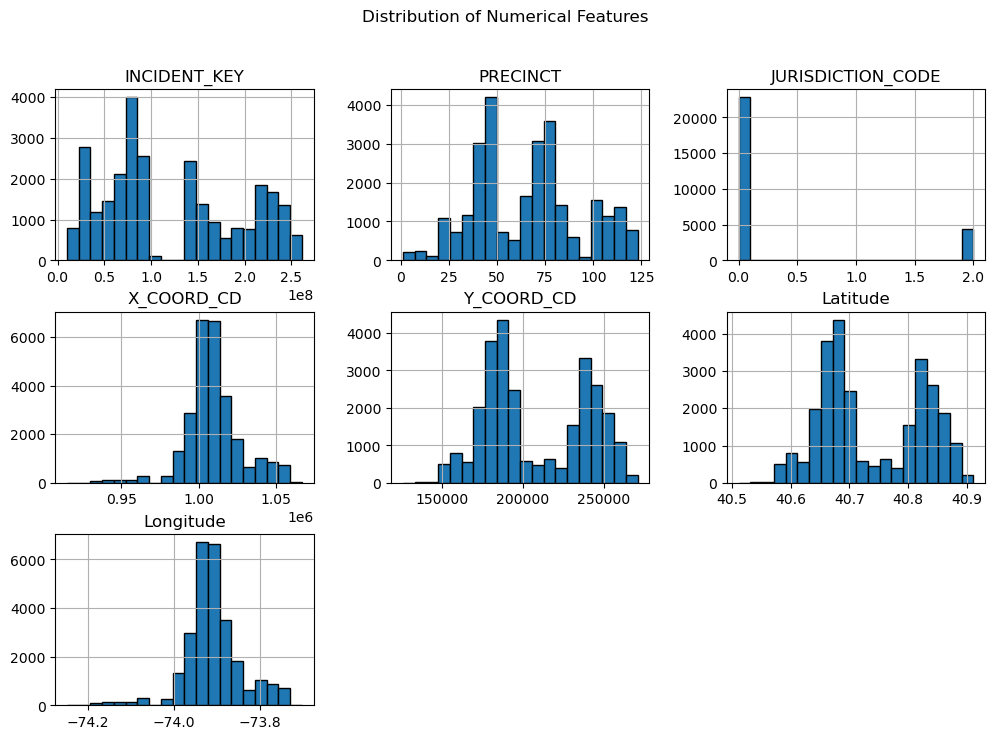

In [15]:
# Univariate Analysis - Visualizing distributions
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns
categorical_cols = df.select_dtypes(include=['object']).columns

# Histograms for numerical columns
df[numeric_cols].hist(figsize=(12, 8), bins=20, edgecolor='black')
plt.suptitle("Distribution of Numerical Features")
plt.show()


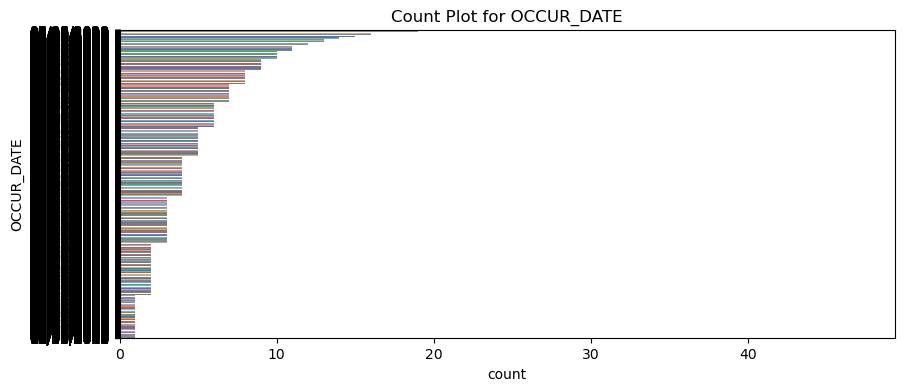

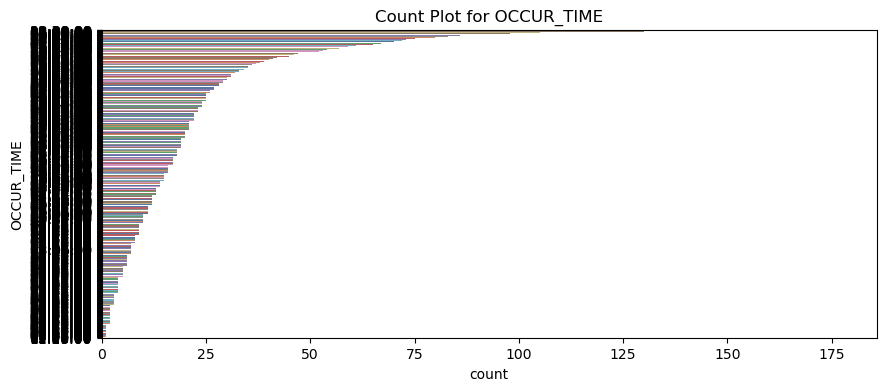

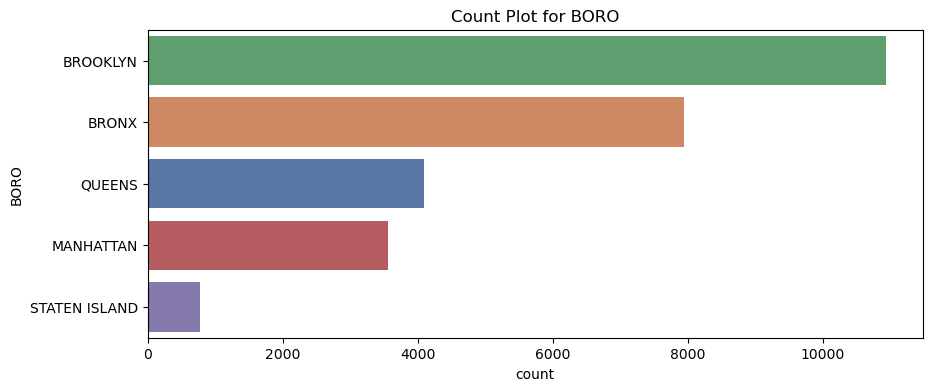

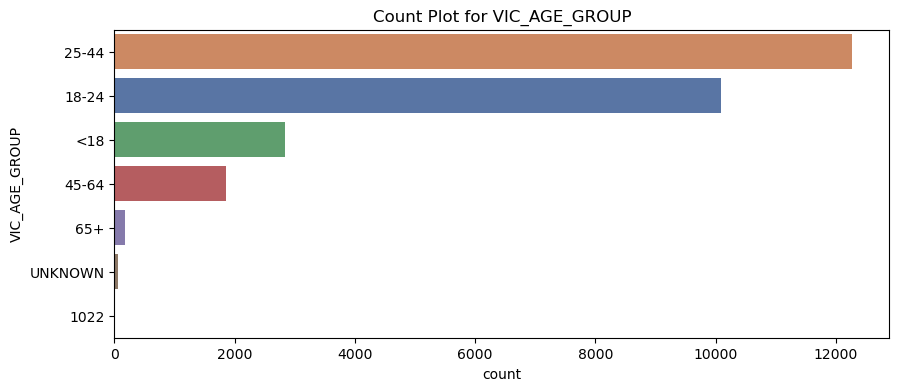

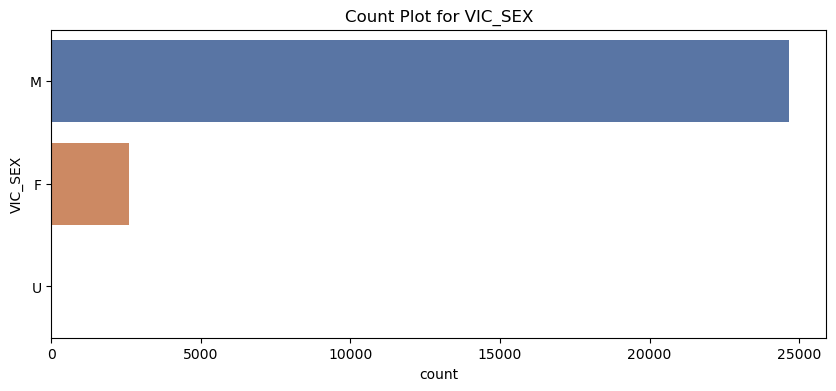

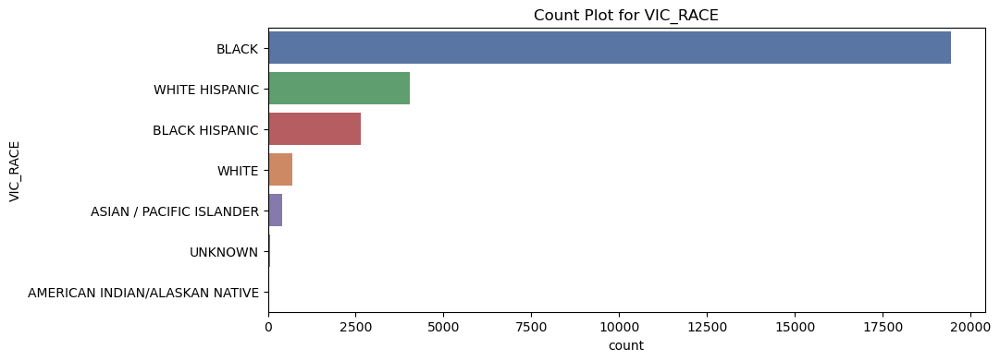

In [16]:
# Count plots for categorical columns
for col in categorical_cols:
    plt.figure(figsize=(10, 4))
    sns.countplot(y=df[col], order=df[col].value_counts().index, hue=df[col], palette='deep', legend=False)
    plt.title(f"Count Plot for {col}")
    plt.show()

In [17]:
# Univariate Analysis - Visualizing distributions
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns
categorical_cols = df.select_dtypes(include=['object']).columns


In [18]:
# Selecting relevant columns for clustering
df_cluster = df[['Latitude', 'Longitude']].dropna()

In [19]:
# Standardizing data
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_cluster)


In [20]:
# Determine optimal clusters using Elbow Method (K-Means)
inertia = []
K_range = range(2, 11)
for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(df_scaled)
    inertia.append(kmeans.inertia_)


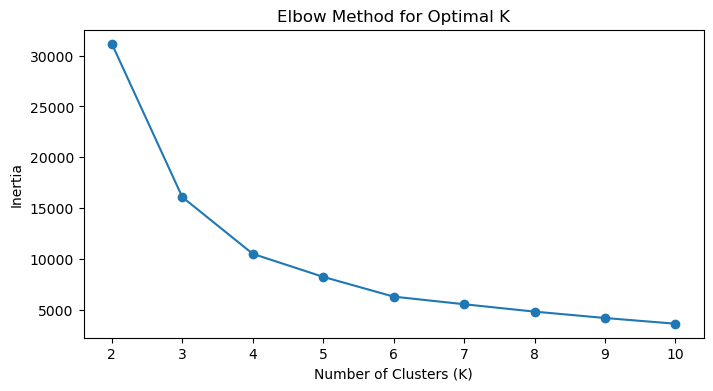

In [21]:
# Plot Elbow Curve
plt.figure(figsize=(8, 4))
plt.plot(K_range, inertia, marker='o', linestyle='-')
plt.xlabel("Number of Clusters (K)")
plt.ylabel("Inertia")
plt.title("Elbow Method for Optimal K")
plt.show()

In [22]:
# Apply K-Means clustering with optimal K (assuming K=4)
optimal_k = 4  # Adjust based on the elbow method result
kmeans = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
df_cluster['Cluster_KMeans'] = kmeans.fit_predict(df_scaled)


In [23]:
# Apply DBSCAN clustering
dbscan = DBSCAN(eps=0.02, min_samples=10)  # Adjust `eps` for better results
df_cluster['Cluster_DBSCAN'] = dbscan.fit_predict(df_scaled)

In [24]:
# Use PCA for visualization
pca = PCA(n_components=2)
df_pca = pca.fit_transform(df_scaled)
df_cluster['PCA1'] = df_pca[:, 0]
df_cluster['PCA2'] = df_pca[:, 1]


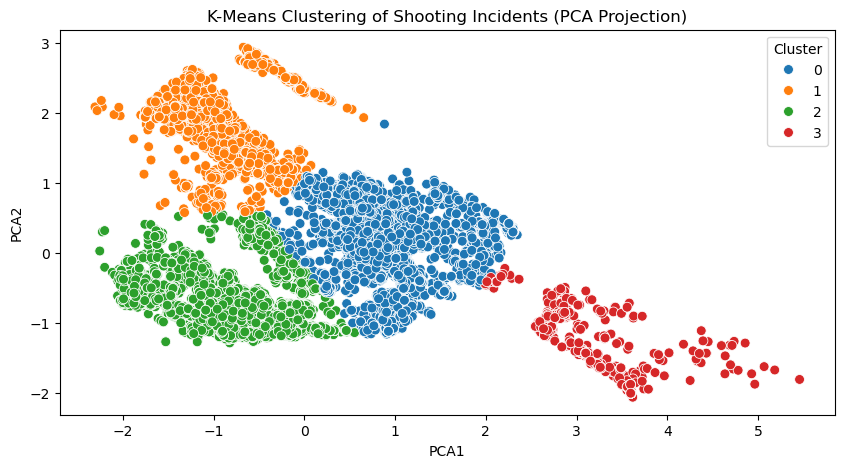

In [25]:
# Visualize K-Means Clustering
plt.figure(figsize=(10, 5))
sns.scatterplot(x=df_cluster["PCA1"], y=df_cluster["PCA2"], hue=df_cluster["Cluster_KMeans"], palette="tab10", s=50)
plt.title("K-Means Clustering of Shooting Incidents (PCA Projection)")
plt.legend(title="Cluster")
plt.show()


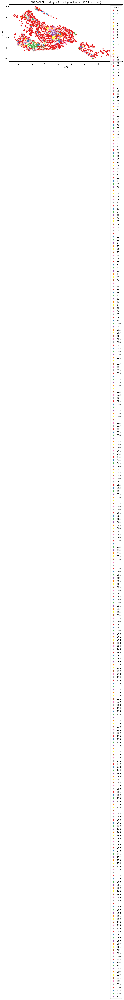

In [26]:
# Visualize DBSCAN Clustering
plt.figure(figsize=(10, 5))
sns.scatterplot(x=df_cluster["PCA1"], y=df_cluster["PCA2"], hue=df_cluster["Cluster_DBSCAN"], palette="Set1", s=50)
plt.title("DBSCAN Clustering of Shooting Incidents (PCA Projection)")
plt.legend(title="Cluster")
plt.show()

In [27]:
# Map Clusters using Folium
map_nyc = folium.Map(location=[df_cluster["Latitude"].mean(), df_cluster["Longitude"].mean()], zoom_start=11)


In [28]:
colors = ['red', 'blue', 'green', 'purple', 'orange']

for _, row in df_cluster.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,
        color=colors[int(row['Cluster_KMeans']) % len(colors)],  # Convert to int
        fill=True,
        fill_color=colors[int(row['Cluster_KMeans']) % len(colors)],  # Convert to int
        fill_opacity=0.6
    ).add_to(map_nyc)

# Show Map
map_nyc


In [14]:
df = df.dropna(subset=['Longitude', 'Latitude'])

In [15]:
if 'Cluster' not in df.columns:
    print("Cluster column missing. Running KMeans clustering...")
    kmeans = KMeans(n_clusters=5, random_state=42)  # Adjust clusters as needed
    df['Cluster'] = kmeans.fit_predict(df[['Longitude', 'Latitude']])

Cluster column missing. Running KMeans clustering...


In [16]:
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.Longitude, df.Latitude))

In [17]:
print("Cluster Counts:\n", df['Cluster'].value_counts())


Cluster Counts:
 Cluster
1    10915
0     6600
4     5322
2     3158
3     1305
Name: count, dtype: int64


In [18]:
cluster_summary = df.groupby('Cluster').agg({'Latitude': ['mean', 'std'], 'Longitude': ['mean', 'std'], 'INCIDENT_KEY': 'count'})
print(cluster_summary)

          Latitude            Longitude           INCIDENT_KEY
              mean       std       mean       std        count
Cluster                                                       
0        40.850600  0.022306 -73.884904  0.024859         6600
1        40.671187  0.023882 -73.929240  0.030351        10915
2        40.673786  0.043633 -73.782743  0.029796         3158
3        40.612575  0.027923 -74.066656  0.064817         1305
4        40.803691  0.026301 -73.933889  0.024194         5322


In [19]:
silhouette_avg = silhouette_score(df[['Longitude', 'Latitude']], df['Cluster'])

In [20]:
print(f"Silhouette Score: {silhouette_avg:.4f}")

Silhouette Score: 0.5060


In [21]:
davies_bouldin = davies_bouldin_score(df[['Longitude', 'Latitude']], df['Cluster'])

In [22]:
print(f"Davies-Bouldin Index: {davies_bouldin:.4f}")

Davies-Bouldin Index: 0.7170


In [23]:
# Dunn Index Calculation
def dunn_index(X, labels):
    distances = squareform(pdist(X, metric='euclidean'))
    intra_dists = [distances[labels == i][:, labels == i].max() for i in np.unique(labels)]
    inter_dists = [distances[labels == i][:, labels == j].min() for i in np.unique(labels) for j in np.unique(labels) if i != j]
    return min(inter_dists) / max(intra_dists)

In [24]:
dunn = dunn_index(df[['Longitude', 'Latitude']].values, df['Cluster'].values)
print(f"Dunn Index: {dunn:.4f}")

Dunn Index: 0.0006
